In [134]:
import pandas as pd
import psycopg2, dash
import plotly.graph_objects as go
from typing import List, Dict
from sqlalchemy import create_engine, text

In [147]:
def get_cube_data(group_fields: List[str], sum_fields: List[str], connection_params: dict) -> pd.DataFrame:
    """    
    Args:
        group_fields: Lista de campos de agrupación (ej. ['cd.country', 'c.card']).
        sum_fields: Lista de campos a sumar (ej. ['ft.count_sale_paid']).
        connection_params: Diccionario con parámetros de conexión (host, dbname, user, password, port).
    
    Returns:
        pd.DataFrame: DataFrame con los resultados de la consulta.
    """
    db_url = (
        f"postgresql+psycopg2://{connection_params['user']}:{connection_params['password']}"
        f"@{connection_params['host']}:{connection_params['port']}/{connection_params['dbname']}"
    )
    engine = create_engine(db_url)

    table_aliases = {
        'country_dimension': 'cd',
        'facts': 'ft',
        'card_dimension': 'c',
        'genero_dimension': 'g',
        'product_dimension': 'pd',
        'meses_dimension': 'm',
        'year_dimension':'y'
    }

    join_conditions = {
        ('country_dimension', 'facts'): 'cd.id_country = ft.country',
        ('card_dimension', 'facts'): 'c.id_card = ft.card',
        ('genero_dimension', 'facts'): 'g.id_genero = ft.gender',
        ('product_dimension', 'facts'): 'pd.id_product = ft.product',
        ('year_dimension', 'facts'): 'y.id_year = ft.year'
    }

    invalid_cols = []
    valid_group_fields = []
    valid_sum_fields = []

    with engine.connect() as conn:
        for field in group_fields + sum_fields:
            table_alias, col_name = field.split('.')
            table_name = next((t for t, a in table_aliases.items() if a == table_alias), None)
            if not table_name:
                invalid_cols.append(field)
                continue

            cols_df = pd.read_sql(
                text(f"SELECT column_name FROM information_schema.columns WHERE table_schema = 'public' AND table_name = '{table_name}'"),
                conn
            )
            facts_cols = set(cols_df['column_name'])

            if col_name not in facts_cols:
                invalid_cols.append(field)
            else:
                if field in group_fields:
                    valid_group_fields.append(field)
                else:
                    valid_sum_fields.append(field)

    if invalid_cols:
        raise ValueError("Estas columnas no existen en las tablas especificadas: " + ", ".join(invalid_cols))

    tables_used = set()
    for field in valid_group_fields + valid_sum_fields:
        table_alias = field.split('.')[0]
        table_name = next(t for t, a in table_aliases.items() if a == table_alias)
        tables_used.add(table_name)

    join_str = "FROM facts ft"
    for table in tables_used:
        if table != 'facts':
            alias = table_aliases[table]
            condition = next(
                (cond for (t1, t2), cond in join_conditions.items() if (t1 == table and t2 == 'facts') or (t2 == table and t1 == 'facts')),
                None
            )
            if condition:
                join_str += f"\nJOIN {table} {alias} ON {condition}"

    group_str = ', '.join(valid_group_fields)
    sum_str = ', '.join([
    f'SUM(CASE WHEN {field} IS NOT NULL THEN CAST({field} AS NUMERIC) ELSE 0 END) AS {field.split(".")[-1]}'
    for field in valid_sum_fields
    ])


    query = f"""
        SELECT {group_str}, {sum_str}
        {join_str}
        GROUP BY CUBE ({group_str})
    """

    with engine.connect() as conn:
        df = pd.read_sql(text(query), conn)

    return df

In [148]:
import plotly.graph_objects as go
import pandas as pd
import numpy as np

def plot_cubes_result_bar3d(df, measure_column='count_sale_paid'):
    """
    Genera un gráfico de barras 3D desde un DataFrame de Cubes.
    
    - df: DataFrame con al menos dos dimensiones categóricas y una medida numérica.
    - measure_column: Nombre de la columna con valores numéricos.
    """
    
    df = df.fillna("Sin dato")

    dimension_cols = [col for col in df.columns if col != measure_column and df[col].dtype == 'object']
    
    if len(dimension_cols) < 2:
        raise ValueError("Se requieren al menos dos columnas categóricas (dimensiones) para el gráfico 3D.")

    dim_x = dimension_cols[0]
    dim_y = dimension_cols[1]

    grouped = df.groupby([dim_x, dim_y])[measure_column].sum().reset_index()

    x_labels = grouped[dim_x].unique().tolist()
    y_labels = grouped[dim_y].unique().tolist()
    
    grouped['x_num'] = grouped[dim_x].apply(lambda val: x_labels.index(val))
    grouped['y_num'] = grouped[dim_y].apply(lambda val: y_labels.index(val))

    fig = go.Figure()

    for _, row in grouped.iterrows():
        fig.add_trace(go.Scatter3d(
            x=[row['x_num'], row['x_num']],
            y=[row['y_num'], row['y_num']],
            z=[0, row[measure_column]],
            mode='lines',
            line=dict(color='blue', width=10),
            name=f"{row[dim_x]} - {row[dim_y]}"
        ))

    fig.update_layout(
        scene=dict(
            xaxis=dict(title=dim_x, tickvals=list(range(len(x_labels))), ticktext=x_labels),
            yaxis=dict(title=dim_y, tickvals=list(range(len(y_labels))), ticktext=y_labels),
            zaxis=dict(title=measure_column)
        ),
        title=f'Barras 3D de {measure_column} por {dim_x} y {dim_y}',
        showlegend=False,
        width=1000,
        height=800
    )

    fig.show()


In [149]:
connection_params = {
    'host': 'localhost',
    'dbname': 'bodegaDeDatos',
    'user': 'root',
    'password': 'root',
    'port': 5433
}

In [150]:
group_fields = ['cd.country', 'c.card', 'pd.product', 'g.genero']
sum_fields = ['ft.count_sale_paid']

df = get_cube_data(group_fields, sum_fields, connection_params)
group_cols = [f.split('.')[-1] for f in group_fields]
sum_cols = [f.split('.')[-1] for f in sum_fields]

In [140]:
df

,country,card,product,genero,count_sale_paid
0,Afghanistan,jcb,Alize Gold Passion,None,1.0
1,Afghanistan,None,Alize Gold Passion,None,1.0
2,Afghanistan,jcb,Almonds Ground Blanched,None,2.0
3,Afghanistan,None,Almonds Ground Blanched,None,2.0
4,Afghanistan,jcb,Appetizer - Chicken Satay,None,1.0
...,...,...,...,...,...
208612,None,None,Ham - Proscuitto,Hombre,14.0
208613,None,None,Apricots - Halves,Mujer,6.0
208614,None,None,Artichoke - Fresh,Mujer,3.0
208615,None,None,Hagen Daza - Dk Choocolate,Mujer,10.0


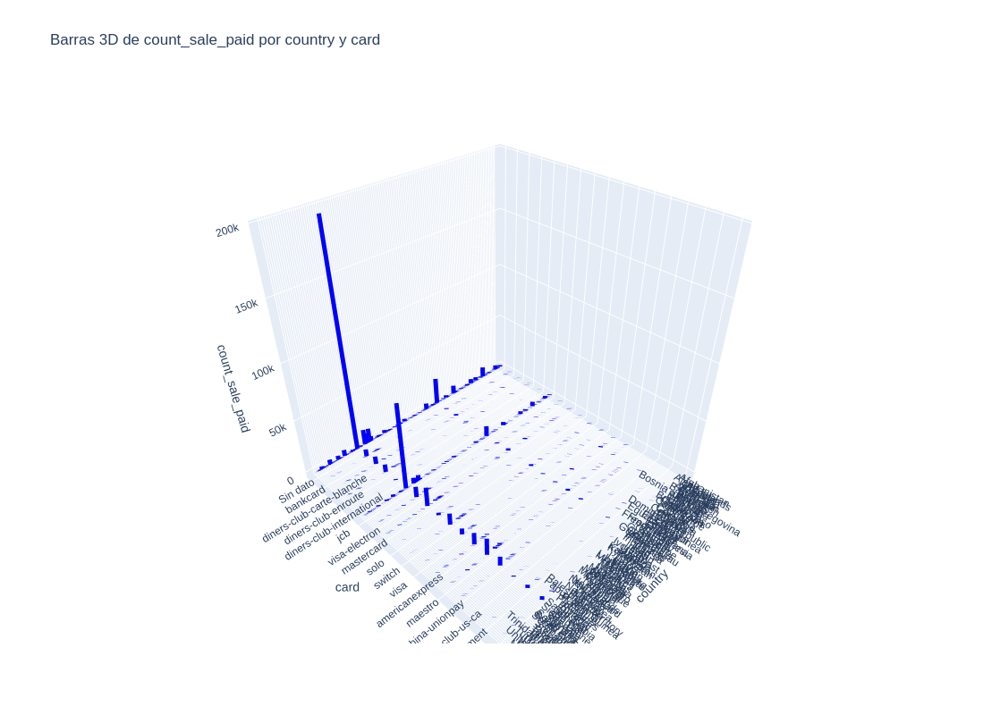

In [115]:
plot_cubes_result_bar3d(df)

In [116]:
group_fields = ['cd.country', 'g.genero']
sum_fields = ['ft.count_sale_paid']

df = get_cube_data(group_fields, sum_fields, connection_params)
group_cols = [f.split('.')[-1] for f in group_fields]
sum_cols = [f.split('.')[-1] for f in sum_fields]

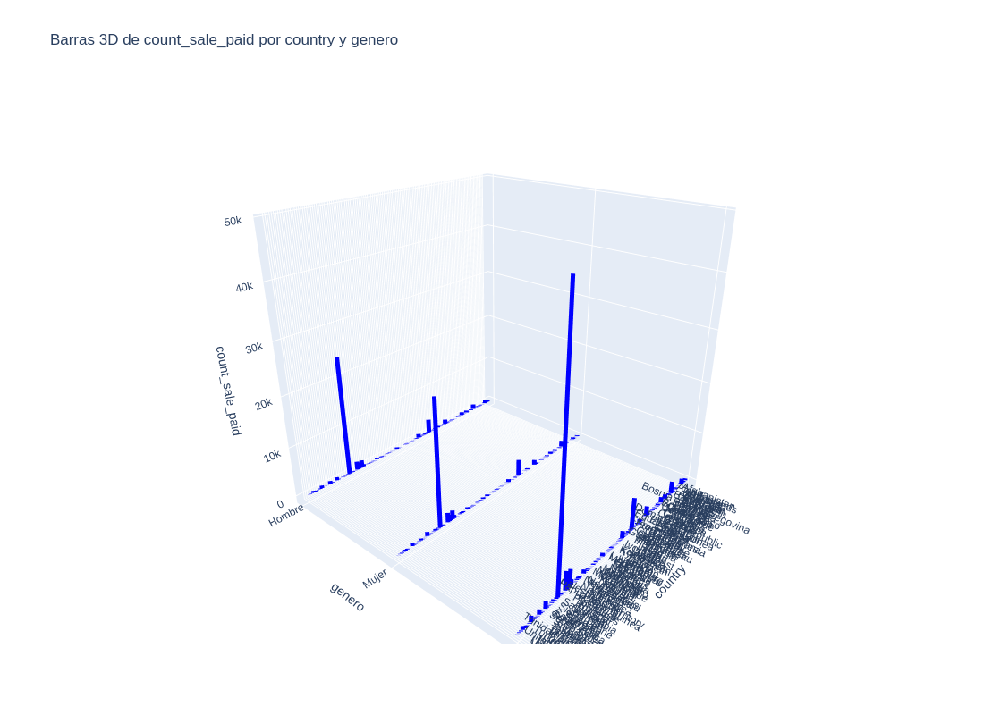

In [110]:
plot_cubes_result_bar3d(df)

In [126]:
group_fields = ['y.year', 'g.genero']
sum_fields = ['ft.count_sale_paid']

df = get_cube_data(group_fields, sum_fields, connection_params)
group_cols = [f.split('.')[-1] for f in group_fields]
sum_cols = [f.split('.')[-1] for f in sum_fields]

In [127]:
df

,year,genero,count_sale_paid
0,NaN,None,48843.0
1,2002.0,Mujer,1142.0
2,2010.0,Mujer,1004.0
3,2008.0,Mujer,1128.0
4,2009.0,Mujer,1125.0
...,...,...,...
61,2009.0,None,2306.0
62,2018.0,None,2330.0
63,2005.0,None,2365.0
64,NaN,Hombre,24135.0


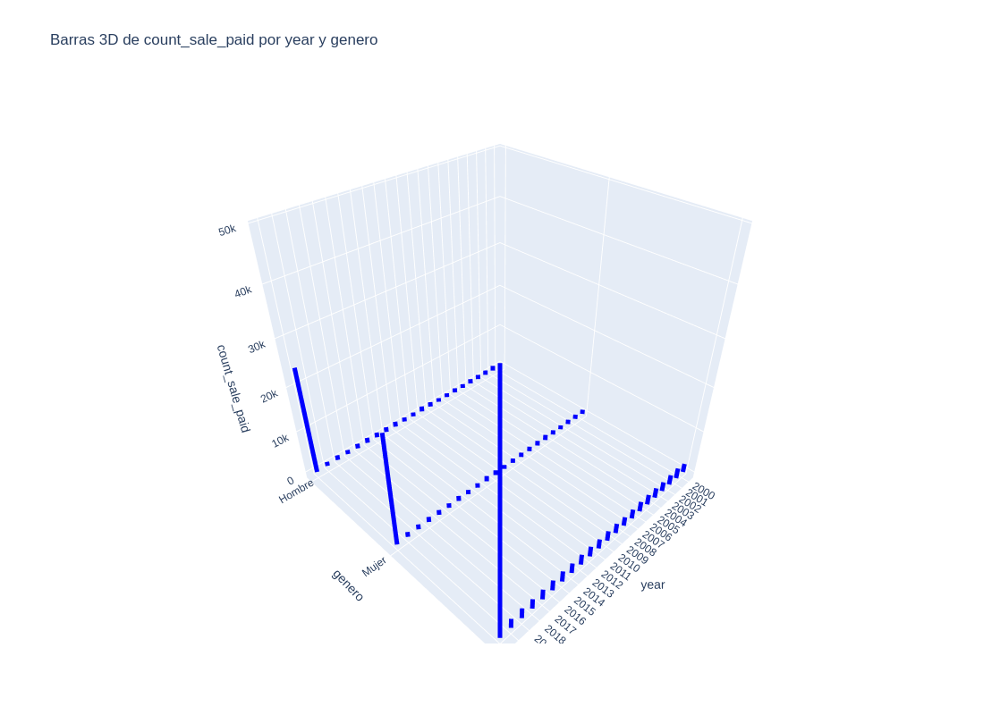

In [128]:
plot_cubes_result_bar3d(df)

In [130]:
group_fields = ['cd.country', 'c.card']
sum_fields = ['ft.count_sale_paid']

df = get_cube_data(group_fields, sum_fields, connection_params)
group_cols = [f.split('.')[-1] for f in group_fields]
sum_cols = [f.split('.')[-1] for f in sum_fields]

In [131]:
df

,country,card,count_sale_paid
0,None,None,48843.0
1,Palestinian Territory,switch,52.0
2,Mongolia,bankcard,29.0
3,Peru,visa-electron,54.0
4,North Korea,jcb,36.0
...,...,...,...
628,None,switch,2769.0
629,None,jcb,19966.0
630,None,visa-electron,2606.0
631,None,mastercard,4596.0


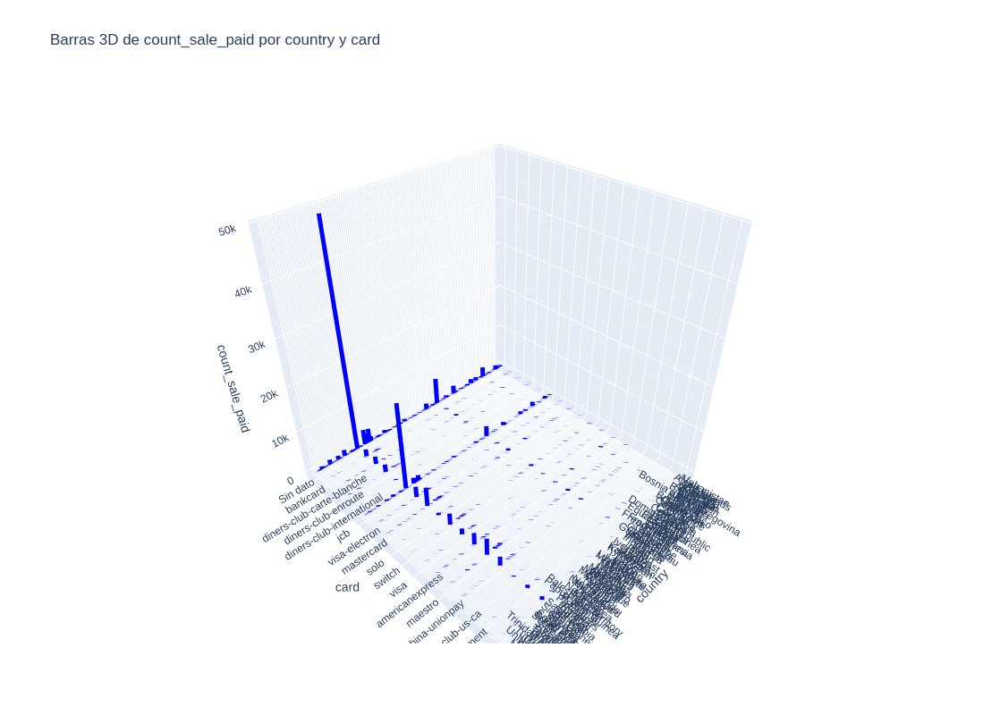

In [132]:
plot_cubes_result_bar3d(df)

In [141]:
group_fields = ['cd.country', 'c.card']
sum_fields = ['ft.min_sale_paid']

df = get_cube_data(group_fields, sum_fields, connection_params)
group_cols = [f.split('.')[-1] for f in group_fields]
sum_cols = [f.split('.')[-1] for f in sum_fields]

In [145]:
df

,country,card,min_sale_paid
0,None,None,2.509516e+09
1,Palestinian Territory,switch,2.198338e+06
2,Mongolia,bankcard,1.145177e+06
3,Peru,visa-electron,3.048631e+06
4,North Korea,jcb,1.872299e+06
...,...,...,...
628,None,switch,1.430507e+08
629,None,jcb,1.031660e+09
630,None,visa-electron,1.327316e+08
631,None,mastercard,2.324103e+08


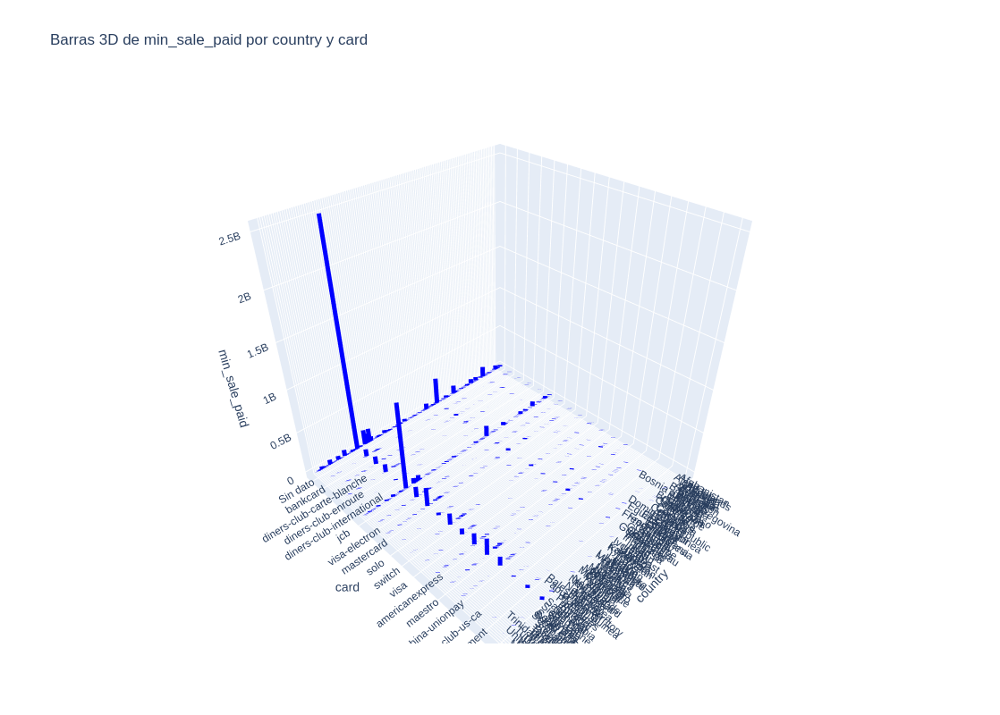

In [146]:
plot_cubes_result_bar3d(df, measure_column='min_sale_paid'min_sale_paid)